### Overview of the notebook

1. [Motivation](#chapter1)<br>
   1.1 [What is our dataset?](#section_1_1)<br>
   1.2 [Why did we choose these particular datasets?](#section_1_2)<br>
   1.3 [What was our goal for the end user's experience?](#section_1_3)<br>
   
2. [Basic statistics](#chapter2)<br>
    2.1 [Cleaning and preprocessing](#section_2_1)<br>
    2.2 [Discussion the dataset stats](#section_2_1)<br>
    
3. [Data Anlysis](#chapter3)<br>
    3.1 [Water complaints in neighborhoods](#section_3_1)<br>
    3.2 [Housing prices in relation to water complaints](#section_3_2)<br>
    3.3 [Contaminants and water complaints in neighborhoods](#section_3_3)<br>
    3.4 [Predictions](#section_3_4)<br>
    3.5 [Errors in the data](#section_3_5)<br>
4. [Genre](#chapter4)<br>
    4.1 [Which genre of data story did we use?](#section_4_1)<br>
    4.2 [Which tools did we from each of the 3 categories of Visual Narrative](#section_4_2)<br>
    4.3 [Which tools did we use from each of the 3 categories of Narrative Structure](#section_4_3)<br>
    
5. [Visualizations](#chapter5)<br>
    5.1 [Explain the visualizations chosen](#section_5_1)<br>
    5.2 [Why are they right for the story we want to tell?](#section_5_2)<br>
    
6. [Discussion](#chapter6)<br>
    6.1 [What went well?](#section_6_1)<br>
    6.2 [What is still missing? What could be improved? Why?](#section_6_1)<br>

7. [References](#chapter7)<br>
    
8. [Contributions](#chapter8)<br>


[Link to website](https://fastidious-salamander-479d34.netlify.app/)

# How New York City Prioritizes Solving its Water Problems

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt 
%matplotlib inline

from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn import metrics
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score
from sklearn.metrics import plot_confusion_matrix
from sklearn.model_selection import RandomizedSearchCV
from sklearn import tree
from sklearn.tree import plot_tree
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error

import json
import math
import plotly.express as px
import geopandas as gdp
from geopandas import GeoDataFrame
from area import area

from bokeh.plotting import figure, show
from bokeh.models import HoverTool, ColumnDataSource, Legend
from bokeh.io import push_notebook, show, output_notebook, curdoc
from bokeh.layouts import layout
from bokeh.models.widgets import Tabs, Panel
from bokeh.io import output_notebook
from bokeh.resources import INLINE
output_notebook(INLINE)

Loading BokehJS ...

## 1. Motivation <a class="anchor" id="chapter1"></a>

### 1.1 What is our dataset? <a class="anchor" id="section_1_1"></a>

Three databases were used to understand the prioritization of water-related problems in New York City.

* [NYC Rolling Sales](https://www1.nyc.gov/site/finance/taxes/property-annualized-sales-update.page)

* [311 Service Requests](https://data.cityofnewyork.us/Social-Services/311-Service-Requests-from-2010-to-Present/erm2-nwe9)

* [Drinkable Water Quality](https://data.cityofnewyork.us/Environment/Drinking-Water-Quality-Distribution-Monitoring-Dat/bkwf-xfky)

Our final dataset consists of the following coloums:

    Month_Year
    Zip_Code
    Median_Sales
    Sum_Sales
    Std_Sales
    Avg_Sales
    Amount_Sales
    Sum_Residential_Units
    Sum_Commercial_Units
    Sum_land_square_Group
    Sum_gross_land_square_Group
    Borough
    Neighborhood
    Avg_Residual_Free_Chlorine
    Avg_Turbidity
    Avg_Fluoride
    Avg_Coliform
    Complaint Type
    Amount of Complaints

The final CSV uploaded to the notebook contains 64.790 rows in total after all the cleaning had been done.

### 1.2 Why did we choose these particular datasets? <a class="anchor" id="section_1_2"></a>

New York city is by far the most popular city in the United State. In such large cities like New York, social class division can often be seen quite clearly. Therefore it might be worth while to take a further look into the discrimination of New Yorkers and look at how New York City prioritizes the wealthy in solving its environmental problems. In this project we will look at how the real estate market behaves in line with living conditions and if people of wealth are prioritised higher than others.

The market prices of properties in New York City consist of several features. Such as location, neighborhood, and environmental impact. It is particularly interesting to examine the effect of water quality on housing prices since the quality of water can affect the health and living conditions of the residents. [Ref: The social wellbeing of NYC](https://asimetrica.it2.com/wp-content/uploads/2020/01/The-Social-Wellbeing-of-New-York-Citys-Neighborhoods_-The-Contri.pdf?fbclid=IwAR2cAlHYTAvGRdtOtYGvMWvbFFre0Mj8mtor-flPggvADeq2LtrxghrTSWI)

To gain further perspective on the issue, we also want to look at water quality data. After reasearching the matter, we found out that there are extreame problems in larger cities when it comes to water quality. Everything from issues with dirty water in rivers, damage in water systems, polluted runoff of sewage and contaminated drinking water. 
For example, in 2019, there was nearly a 50% chance that sewage contamination made it dangerous to touch the water anywhere in New York City. [Ref: Sewage overflow](https://www.nrdc.org/experts/larry-levine/nycs-new-plan-would-let-massive-sewage-overflows-continue)



### 1.3 What was our goal for the end user's experience? <a class="anchor" id="section_1_3"></a>

The goal for the end user's experience is to understand what New York City's major water problems are, and how much it affect the city. We also want the user to observe if those who live in neighborhoods with greater poverty rates have worse water quality than others and if their water contains more contaminants. Finally, we want the user to comprehend the distinction between the top and lowest classes when it comes to water quality.

## 2. Basic statistics <a class="anchor" id="chapter2"></a>

### 2.1 Data cleaning and preprocessing <a class="anchor" id="section_2_1"></a>

The first dataset, NYC Rolling Sales contains housing sales prices and sales date for 42 different neighborhoods in New York. The cleanup of this dataset involved extracting the annual sales data in different neighborhoods of the city from 2010 to 2015. A total of 55 CSV files were used and they joined and aggregated together in order to analyze the evolution of the house prices in the city.

Next dataset, 311 Servise Requests contains information about requests made from residents of a non-emergency problems from the years 2010-2021. This is an extreamly massive datatset with more that 24 million requests by city residents. The CSV file is 16gb which made it a challenge to work with in pandas. It was decided to look for an external software to help with this problem and perform initial cleaning only for water related requests, to reduce the size of the dataset. The Aleryx software was used that is able to deal well with bid data and distributed computing. Below is a picture of the flow used to extract the following complains:

    Air Quality
    Dirty Conditions
    General Construction/Plumbing
    Hazardous Materials
    Indoor Air Quality
    Industrial Waste
    Plumbing
    Rodent
    Root/Sewer/Sidewalk Condition
    Sewer
    Water Quality
    Water System
    Asbestos
    Beach/Pool/Sauna Complaint
    Drinking Water
    Indoor Sewage
    Unsanitary Condition
    Asbestos/Garbage Nuisance
    Mosquitoes
    Illegal Dumping
    Dumpster Complaint
    
    
The main function of the data flow is to load the raw database and filter out only water-related complaints so that we can clean up in pandas.


![flow](flow.png)


It was then decided to only go with 7 of these complaints that were the most related with the goal of the assignment, that is Water System, Water Quality, Drinking Water, Plumbing, Sewer, Root/Sewer/Sidewalk Condition, Indoor Sewage.

The final dataset, Drinkable Water Quality contains data with the amount of Turbidity, Fluoride, Coliform and Chlorine along with other features not use for this assignment from the years of 2015 to 2021. This dataset was used to understand the environmetal problems of New York even better. It was quite challengin to combine this dataset with the other ones, as the locations of the measures were not revealed. However, this dataset supports informing EPSG coodinates that made it possible to extract the latitude and logitude by an API and using the reverse geocode method.

By clicking this link [here](https://nbviewer.org/github/Gunnhildurkatrin/SocialData2022/blob/main/Database%20Merging.ipynb) you can see a more detailed version and the code for the data cleaning.

In [3]:
# read data from csv file
data = pd.read_csv('Cleaned_data.csv')

In [4]:
# only use the data that contains the water complaints
water_data = data[data['Complaint Type'].isin(set(['Water System','Water Quality','Drinking Water',
                                        'Plumbing','Sewer','Root/Sewer/Sidewalk Condition','Indoor Sewage']))]

In [5]:
# set date column to datetime object
water_data = water_data.copy()
water_data['Month_Year'] = pd.to_datetime(water_data['Month_Year'], format="%Y-%m")
water_data['Year'] = pd.DatetimeIndex(water_data['Month_Year']).year
water_data['Month'] = pd.DatetimeIndex(water_data['Month_Year']).month

In [6]:
# Only take years 2015-2021
water_data = water_data[water_data['Year']>=2015].reset_index()
del water_data['index']

In [7]:
# change the name of zip code to postalcode for use later
water_data = water_data.rename(columns={"Zip_code": "postalcode"})

In [8]:
# drop columns that are not used
water_data = water_data.drop(columns=['Avg_Land_sqft', 'Avg_gross_land_square_Group', 
        'Std_Residual_Free_Chlorine','Count_of_Residual_Collections_Group',
        'Std_Turbidity','Std_Fluoride','Count_of_Turbidity_Collections','Std_Coliform',
        'Count_of_Coliform_Collections','Count_of_Fluoride_Collections'])

In [9]:
# make a new dataframe for the predictions later
water_data = water_data[water_data['Year']>=2015].reset_index()
del water_data['index']

In [10]:
# fill inn the missing values with the mean value for these four columns
water_data['Avg_Residual_Free_Chlorine'] = water_data['Avg_Residual_Free_Chlorine'].\
                                        fillna(water_data['Avg_Residual_Free_Chlorine'].mean())

water_data['Avg_Turbidity'] = water_data['Avg_Turbidity'].\
                                        fillna(water_data['Avg_Turbidity'].mean())

water_data['Avg_Fluoride'] = water_data['Avg_Fluoride'].\
                                        fillna(water_data['Avg_Fluoride'].mean())

water_data['Avg_Coliform'] = water_data['Avg_Coliform'].\
                                        fillna(water_data['Avg_Coliform'].mean())

In [11]:
water_data.head()

,Month_Year,postalcode,Median_Sales,Sum_Sales,Std_Sales,Avg_Sales,Amount_Sales,Sum_Residential_Units,Sum_Commercial_Units,Sum_land_square_Group,...,Borough,Neighborhood,Avg_Residual_Free_Chlorine,Avg_Turbidity,Avg_Fluoride,Avg_Coliform,Complaint Type,Amount of Complaints,Year,Month
0,2015-01-01,10001,2015000.0,161415906.0,2.331051e+07,8.967550e+06,18,7.0,38.0,28267.0,...,Manhattan,Chelsea and Clinton,0.444000,0.968000,0.714758,0.0,Plumbing,20.0,2015,1
1,2015-01-01,10001,2015000.0,161415906.0,2.331051e+07,8.967550e+06,18,7.0,38.0,28267.0,...,Manhattan,Chelsea and Clinton,0.444000,0.968000,0.714758,0.0,Sewer,6.0,2015,1
2,2015-01-01,10001,2015000.0,161415906.0,2.331051e+07,8.967550e+06,18,7.0,38.0,28267.0,...,Manhattan,Chelsea and Clinton,0.444000,0.968000,0.714758,0.0,Water System,54.0,2015,1
3,2015-01-01,10002,625000.0,65461500.0,7.922669e+06,3.636750e+06,18,5.0,12.0,10651.0,...,Manhattan,Lower East Side,0.498571,1.008571,0.840000,0.0,Plumbing,21.0,2015,1
4,2015-01-01,10002,625000.0,65461500.0,7.922669e+06,3.636750e+06,18,5.0,12.0,10651.0,...,Manhattan,Lower East Side,0.498571,1.008571,0.840000,0.0,Sewer,10.0,2015,1


### 2.2 Discussion about dataset statistics <a class="anchor" id="section_2_2"></a>

Analysing the average housing price in New York, within different neighbourhoods can give us an insight into the inequalities between areas. 

In [12]:
# calculate the least expensive and most expensive neighborhood
price_by_zip = water_data.groupby('Neighborhood')['Sum_Sales'].mean().sort_values(ascending = False)
print('The least expensive neighbourhood is', price_by_zip.idxmin(),'with average price at $',int(price_by_zip.min()))
print('The most expensive neighbourhood is', price_by_zip.idxmax(),'with average price at $',int(price_by_zip.max()))

The least expensive neighbourhood is Port Richmond with average price at $ 10281055
The most expensive neighbourhood is Chelsea and Clinton with average price at $ 255221632


Above is a calcuation of the least expensive and the most expensive neighborhoods in New York. When taking a further look into Port Richmond, it did not come as a surprise that the neighborhood is not a very popular place to live in compared to the rest of New York.

However, when looking into Chelse and Clinton, that neighborhood is said to be one of the best places to live in New York that offers the residents a good living conditions. [Ref: Chelsea](https://www.niche.com/places-to-live/n/chelsea-new-york-city-ny/?fbclid=IwAR3QlG12xYKBFKreXVPyuDTrocOnJ-)

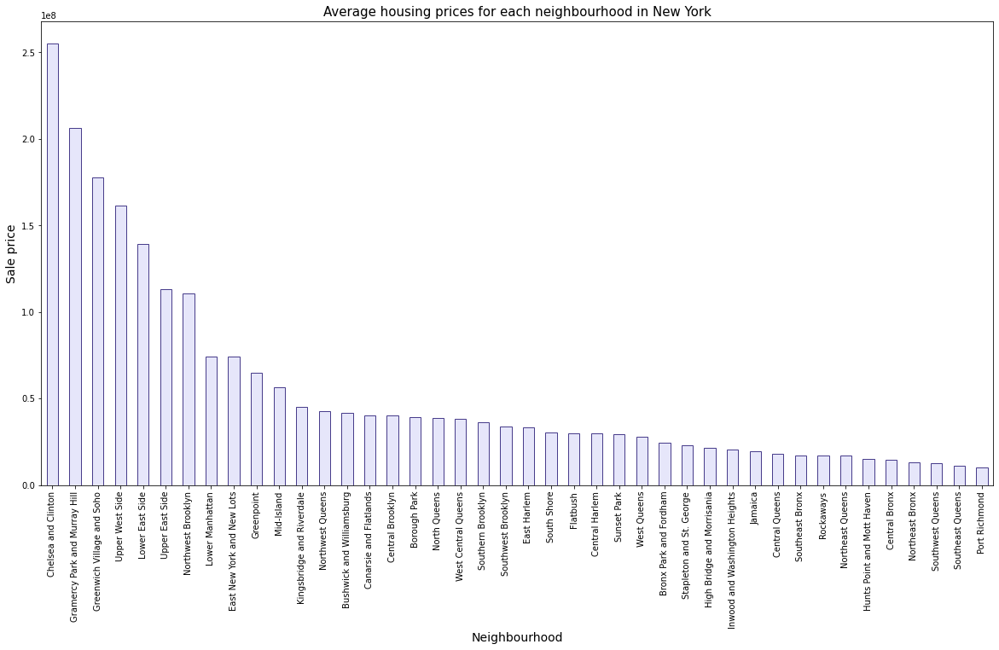

In [13]:
# plot average housing price for all neighborhoods in the dataset
price_by_zip.plot(kind='bar',figsize=(20,10), color='lavender', edgecolor='darkslateblue')
plt.ylabel('Sale price', fontsize=14)
plt.xlabel('Neighbourhood', fontsize=14)
plt.title('Average housing prices for each neighbourhood in New York', fontsize=15);

New York City housing prices are known for being expensive and housing prices can vary vastly from neighborhoods. As mention above, Chelsea and Clinton is the most expensive neighborhood in the dataset. From the figure it is clear that the difference between the most expencive neighborhoods and the less expensive neighbourhoods is significant, with the first 7 neighborhoods being tremendously higher than the rest.

In [14]:
# calculate the neighborhood with least complaints and most complaints
comp_by_neigh = water_data.groupby('Neighborhood')['Amount of Complaints'].sum().sort_values(ascending=False)
print('The neighbourhood with least water complaints is', comp_by_neigh .idxmin(), 'with', comp_by_neigh.min(), 
                                                                                                      'complaints')
print('The neighbourhood with most water complaints is', comp_by_neigh .idxmax(), 'with', comp_by_neigh.max(), 
                                                                                                      'complaints')

The neighbourhood with least water complaints is Lower Manhattan with 3471.0 complaints
The neighbourhood with most water complaints is Central Brooklyn with 56044.0 complaints


Here are shown the two neighborhoods with the lest and the most amount of water complaints in the dataset. When searching the internet on water quality in Central Brooklyn, we could not see any major difference compared to other neighborhoods. However the water in Central Brooklyn does have several contaminants in its water, so it will be very interesting to explore the water quality in that area even further. Lower Manhattan has the fewest complaints, and it is located in the more expensive part in the housing prices graph above.

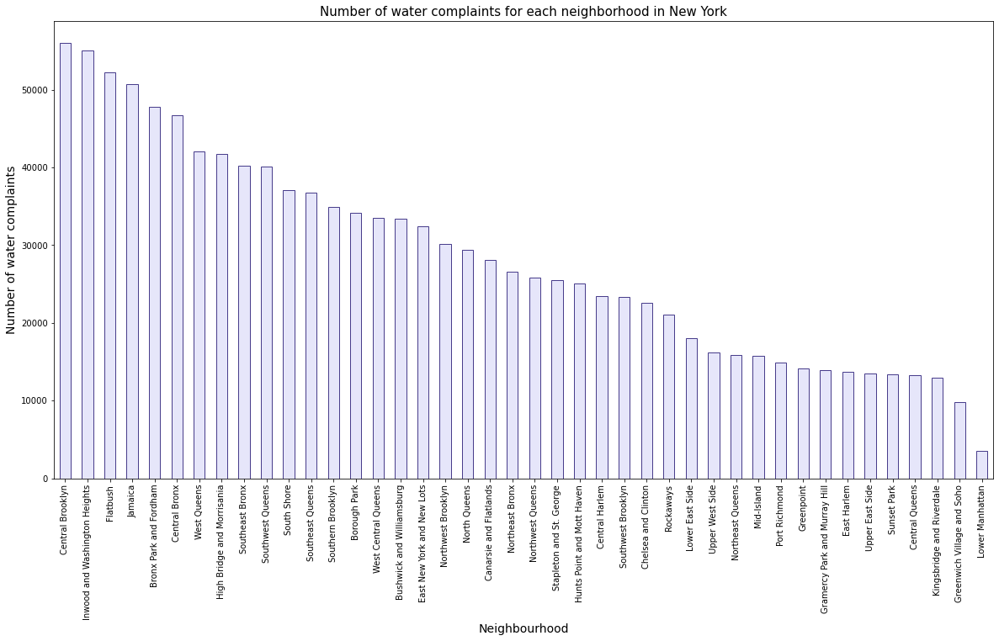

In [15]:
# plot number of water complaints for all the neighbohoods in the dataset
comp_by_neigh.plot(kind='bar',figsize=(20,10),color='lavender', edgecolor='darkslateblue')
plt.ylabel('Number of water complaints', fontsize=14)
plt.xlabel('Neighbourhood', fontsize=14)
plt.title('Number of water complaints for each neighborhood in New York', fontsize=15);

Above is an overview of the number of water complaints for all the neighborhoods in the dataset. There is evident difference between number of complaints within neighborhoods.

In order to provide a visual summary of the data and be able to quickly identify mean values, the dispersion of the data set and signs of skewness a box plot was created, showing the number of complaints in each neighborhood.

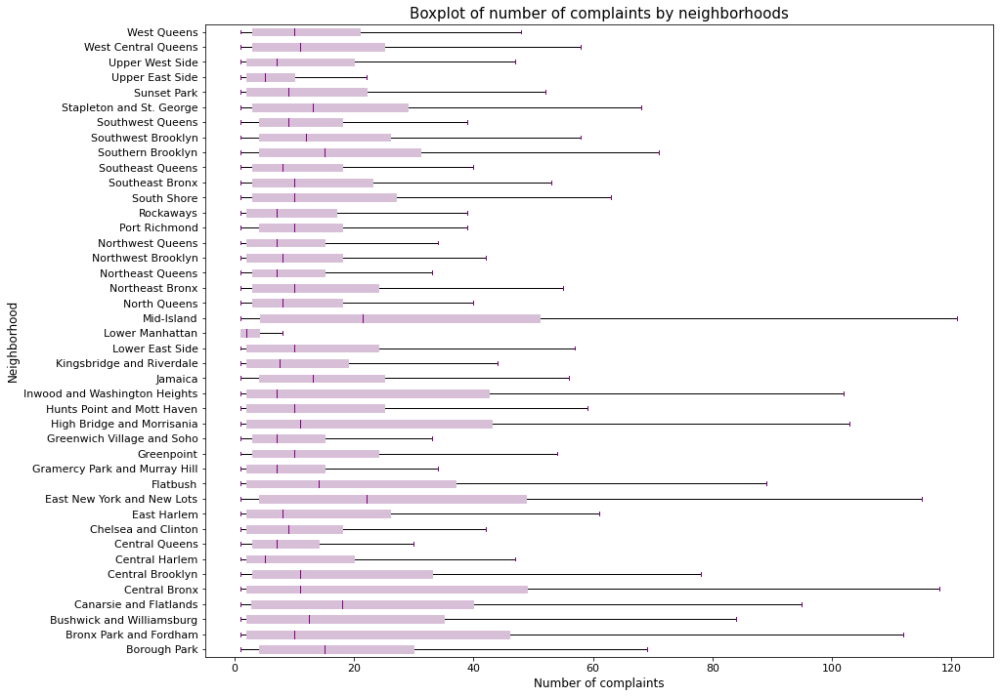

In [16]:
props = dict(boxes="thistle", whiskers="black", medians="purple", caps="purple")

means_df = water_data
means = means_df.groupby(['Neighborhood'])['Amount of Complaints'].agg(np.mean).sort_values()
ordered= means.index.values

# create categorical data type and set categorical column as new data type
dtype = pd.CategoricalDtype(ordered, ordered=True)


# ordered boxplot
means_df.boxplot(by='Neighborhood', 
                    column=['Amount of Complaints'], 
                    figsize=(14, 12),
                    color=props,
                    grid=False,
                    showfliers=False,
                    patch_artist=True,
                    vert=False );
_ = plt.gcf().suptitle('Per Neighborhood',fontsize=14)

# get rid of "boxplot grouped by" category
plt.suptitle("")


# label adjustment
p = plt.gca()
p.set_xlabel("Number of complaints", fontsize=12)
p.set_ylabel("Neighborhood", fontsize=12)
p.set_title("Boxplot of number of complaints by neighborhoods", fontsize=15)
p.tick_params(axis='y', labelsize=11)
p.tick_params(axis='x', labelsize=11);

The plot above shows the number of complaints in each neighborhood in the dataset. The purple line in the middle of the boxes indicates the average complaint in each neighborhood. From this plot it is again clear Central Bronx is the neighborhood with the most complaints in the dataset. 

Furthermore, from this we see that Mid-Island is the most distributed complaint frequence. As there were so many outliers when making the figure, it was decided to visualize it without them, in order to perceive it more clearly. 
Even though the outliers were removed, the figure still shows the overall behavior of the data.

## 3. Data analysis <a class="anchor" id="chapter3"></a>

Now lets expore even further how water complaints behave within neighborhoods, then how the housing price factor affects the behaviour of complaints and finally dig deeper into the water complaints and expore the contaminants that can exist in the water. Then predictions on water complaints will be implemented using as featrues the previously mentioned elements. Lastly, errors in the data will be discussed.

### 3.1 Water complaints in neighborhoods  <a class="anchor" id="section_3_1"></a>

Rapid population expansion, urbanization and economic development has put an increasing demand on water supplies. Even though water issues differ vastly between countries, we all have the same goal of managing our water resources in a sustainable way. Water pollution is already one of the most important concerns in cities across the world, having major consequences for human health and ecosystem sustainability. [Ref: Water in Cities](https://www.ais.unwater.org/ais/pluginfile.php/551/course/section/186/Water_in_Cities_Dvd-brochure.pdf)


Lets look at how water complaints are developing in neighborhoods in the city of New York over the last 6 years.

In [17]:
nycmap = json.load(open("nyc_zip_code_tabulation_areas_polygons.geojson"))

In [18]:
map_comp = water_data.groupby(['Year','postalcode'])['Amount of Complaints'].sum()
map_comp = map_comp.reset_index() #creating tabular data
map_sales = water_data.groupby(['postalcode', 'Year'])['Median_Sales'].mean()
map_sales = map_sales.reset_index() #creating tabular data

In [19]:
# filter out values that seem to be errors
map_sales = map_sales[map_sales.postalcode != 10112]
map_sales = map_sales[map_sales.postalcode != 10179]
map_sales = map_sales[map_sales.postalcode != 10018]

map_comp = map_comp[map_comp.postalcode != 10112]
map_comp = map_comp[map_comp.postalcode != 10179]
map_comp = map_comp[map_comp.postalcode != 10018]

In [59]:
fig = px.choropleth_mapbox(map_comp,
                           geojson=nycmap,
                           featureidkey='properties.postalcode',
                           locations='postalcode',
                           color='Amount of Complaints',
                           hover_name='postalcode',
                           color_continuous_scale='viridis',
                           animation_frame='Year',
                           mapbox_style='carto-positron',
                           title='Cumulative Numbers of Complaints in NYC',
                           center={'lat':40.7, 'lon':-73.9},
                           zoom=9,
                           opacity=0.75,
                           width=1000,
                           height=800
                          )
fig.show()

The figure above shows a map of the famous New York City. The number of complains are shown in colors over the neighborhoods from 2015 to 2021.  The yellow color indicates the area with most complaints while the darker blue colors are the neighborhoods with fewer complaints. The figure shows that more complaints tend to be located either on the north side of the city or in the south/south-west part. Those parts are the boroughs Brooklin, Bronx and Statten Island.

Now, that we have seen where the complaints are located, lets look even further into what those complaints really are.  The complaint types regarding water quality within the dataset are the following:

 - Plumbing
 - Sewer
 - Water System
 - Water Quality
 - Root/Sewer/Sidewalk Condition
 - Indoor Sewage
 - Drinking Water
 
Analysis on each complaint type in the dataset were done, showing the number of complaints for all neighborhoods.

In [22]:
def bokeh_plot(df, tit):
    src = ColumnDataSource(data = df)
    x = df['Neighborhood'].unique() #Complaint types
    hover = HoverTool(tooltips=[('Number of complaints',   '@{Amount of Complaints}')])
    #Create an empty figure
    p = figure(plot_width = 900
               ,plot_height = 600
               ,title = tit
               ,y_axis_label = 'Number of complaints'
                ,x_axis_label = 'Neighborhood'
               ,x_range = x
              ,tools=[hover])

    #bar_cols = ['Complaint_type_count']
    colors = ["lightsteelblue"]
    legends = ['Total n. of complaints', 'N. complaints']

    #Add bars by using p.var
    col = ['Neighborhood','Amount of Complaints']
    bar ={} 
    items = []
    for indx,i in enumerate(col):
        bar[i] = p.vbar(x='Neighborhood', top=i, source= src, width=0.5,\
                        color="lavender",line_color = "darkslateblue")
        items.append((i, [bar[i]]))

    
    p.title.text_font_size = '14pt'
    p.title.align = 'center'
    p.xaxis.major_label_orientation = 1
    return p

In [23]:
# make the tabs for complaint types
complaints = water_data['Complaint Type'].unique()
all_tabs = []
for c in complaints:
    df = water_data[water_data['Complaint Type']== c]
    df_compl = df.groupby(['Neighborhood'])['Amount of Complaints'].sum().reset_index()
    tit = str(c)+' complaints'
    p = bokeh_plot(df_compl, tit)
    tab = Panel(child=p , title = c)
    all_tabs.append(tab)

tabs = Tabs(tabs=all_tabs)
show(tabs)

By clicking on the tabs in the figure above, one can examine each complaint type in the dataset, and how it varies over the neighborhoods. The graph shows that plumbing is by far the most common complaint type in the dataset and it is especially frequent in Bronx Park and Fordham, Central Bronx, Central Brooklyn, Flatbush, High Bridge and Morrisania and Inwood and Washington Heights. Interestingly all the mentioned neighborhoods are located in the same borough, Bronx. For the sewer complaint type, there is only one neighborhood that really stand out and that is Jamaica, which is one of the neighborhoods with lower housing prices. Additionally, it is noticable when looking at the scale on the y-axis that driking water complaints are fairly low overall neighborhoods compared to the other water complaint types.


Next, it was explored if there are specific complaint types that happen much more in certain neighborhoods then what is typical. In order to be able to visualize this without being to confusing and giving an overflow of information, it was decided to examine in more detail only the top 10 neighborhoods having the highest number of complaints. We assume that the ratio for the top 10 neighborhoods with the highest number of complaints reveal the overall information needed from the whole dataset, since the other neighborhoods would most likely not show anything extraordinary. 


For the top 10 neighborhoods the ratio below is calculated :

$$ratio = \frac{P(complaint|neighbourhood)}{P(complaint)}$$

To be able to find the ratio, we need to caluclate the probability of complaint happening given that it is in a certain neighborhood:

$$P(complaint|neighbourhood) = \frac{P(complaint,neighbourhood)}{P(neighbourhood)}$$

and the probability of a complaint:

$$P(complaint)$$


First the probability of living in a neighborhood, $P(neigborhood)$ was visualized.

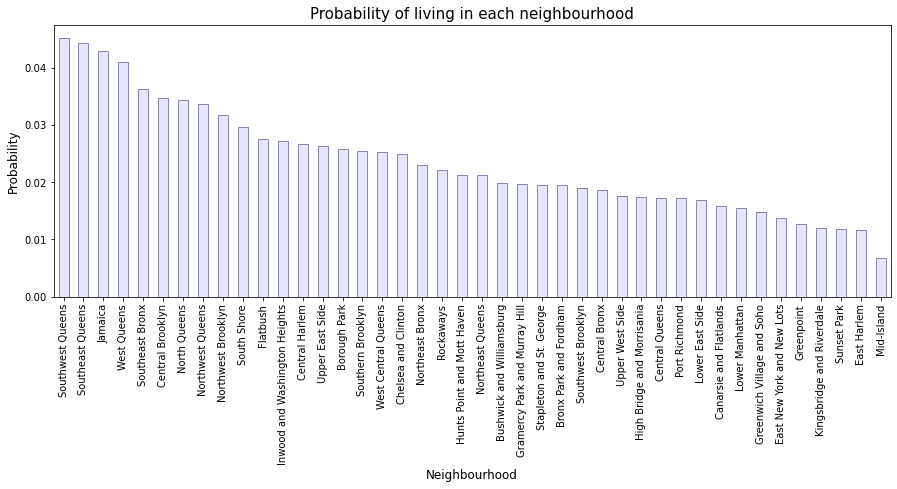

In [24]:
#P(Neighborhood)
p_neigh = water_data['Neighborhood'].value_counts().div(len(water_data))
p_neigh.plot(kind='bar', figsize=(15,5), color='lavender', edgecolor='darkslateblue', linewidth=0.6);
plt.title("Probability of living in each neighbourhood", fontsize=15);
plt.xlabel('Neighbourhood', fontsize=12)
plt.ylabel('Probability', fontsize=12);

Above you can see the distribution over the probability of living in a certain neighborhood for all neighborhoods in the dataset. As there are so many neighborhoods in New York, the probability of living in each area is not very high.

Finally, the ratio is visalized for the top 10 neighborhoods with the highest number of complaints.

In [25]:
#P(complaint)
p_comp = water_data['Complaint Type'].value_counts().div(len(water_data))

# P(complaint|neighborhood)=P(complaint,neighbourhood)/P(complaint)
# probability of number of complaints happening given neighbourhood
p_comp_given_neigh = water_data[['Neighborhood','Complaint Type']].value_counts()\
        .div(len(water_data)).div(p_neigh, axis=0, level='Neighborhood')

#P(complaint|neighborhood) / P(complaint)
ratio = p_comp_given_neigh.div(p_comp, axis=0, level = 'Complaint Type')

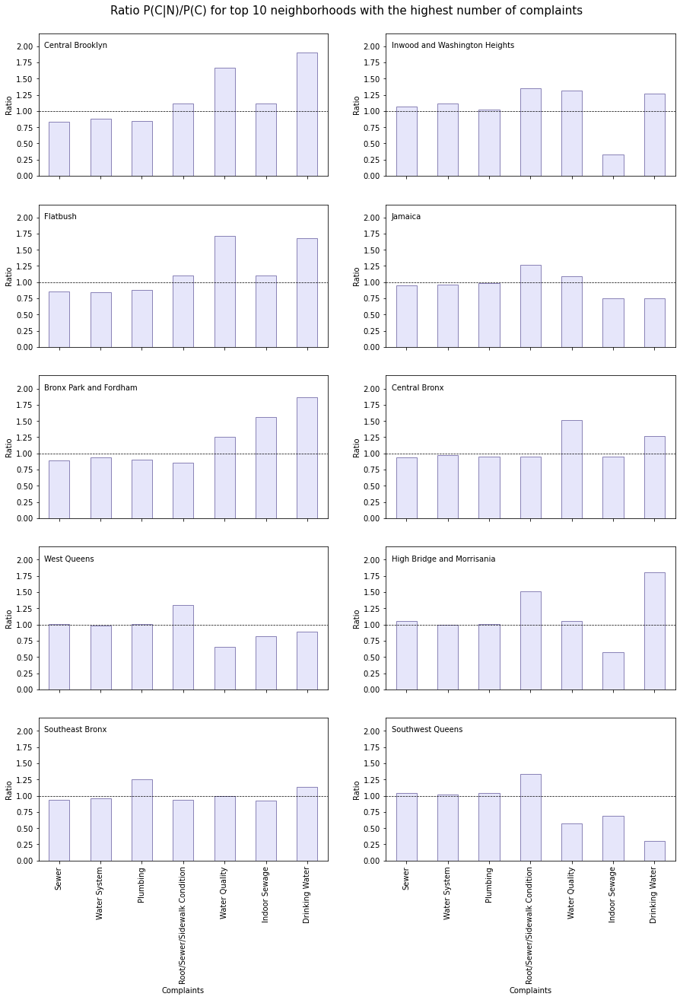

In [26]:
# plot the ratio
top10_neigh_comp = list(comp_by_neigh[:10].index)
nrows = int(len(top10_neigh_comp)/2)
ncol = 2
fig, axes = plt.subplots(nrows, ncol, sharex=True,  figsize =(15,20))

count = 0
for row in range(nrows):
    for col in range(ncol):
        neigh = top10_neigh_comp[count]
        
        ax = ratio[neigh].plot(ax = axes[row, col], kind='bar', 
                                    color='lavender', edgecolor='darkslateblue', linewidth=0.6)
        ax.set_xlabel('Complaints')
        ax.set_ylabel('Ratio')
        
        ax.axhline(y=1, color='black',linestyle = '--', lw=0.7)
        
        ax.set_ylim([0, 2.2])
        ax.text(0.02,0.9, neigh, transform=ax.transAxes)
        count += 1  
        
fig.text(0.5, 0.9, 'Ratio P(C|N)/P(C) for top 10 neighborhoods with the highest number of complaints', 
                                                                             ha='center', va='center', fontsize=15);

The figures show the ratio $\frac{P(complaint|neighbourhood)}{P(complaint)}$ for the top 10 neighborhoods. The ratio is equal to 1 if a complaint occurs at the same level within a neighbourhood as in the city as a whole. If it's greater than 1, it means that the complaint occurs more frequently within that neighourhood. If it's smaller than 1, it means that the complaint is rarer within the neighbourhood in question than in the city as a whole. A benchmark was set at 1, by drawing a stright line over the plots, to make it easier to see where a complaint type is exceeding the ratio of 1 and therefore is happening more frequently within that neighborhood.


Analysing the figures, the neighborhoods that appear to have the highest ratio are Central Brooklyn, Flatbush, Bronx park and Fordham and High Bridge and Morrisiana. All the mentioned neighborhoods except for Central Brooklyn, are in the Bronx borough.

### 3.2 Housing prices in relation to water complaints  <a class="anchor" id="section_3_2"></a>

From housing prices within neighborhoods it can be indicated wheather residents of that neighborhood are wealthy or not. Median is often used instead of the mean for housing prices since few unusually high or low prices can skew the mean price and will for that reason not be an accurate indication of the actual price. [Ref: Median for housing prices](https://www.westpac.com.au/personal-banking/home-loans/median-house-prices-explained/)

An additional factor, that is the median housing sales price, will be incorperated into the water complaint analysis.

First, lets explore a map of the average of the median housing price over the whole city of New York for the last years 2016-2021.

In [27]:
# plot the map for median sales
fig = px.choropleth_mapbox(map_sales,
                           geojson=nycmap,
                           featureidkey='properties.postalcode',
                           locations='postalcode',
                           color='Median_Sales',
                           hover_name='postalcode',
                           color_continuous_scale='viridis',
                            animation_frame='Year',
                           mapbox_style='carto-positron',
                           title='Cumulative Numbers for housing prices in NYC',
                           center={'lat':40.7, 'lon':-73.9},
                           zoom=9,
                           opacity=0.75,
                           width=1000,
                           height=800
                          )
fig.show()

For the map above it is clear that the housing prices are not changing much throughout the years. Not surprisingly, there is an increase in sales price over the years, it can't be seen exactly from the colors of the map as the colored scale expands over the years. In 2015 the scale goes from 0.5M to 3M, compared to 2021, the scale goes from 2M to 16M.

Overall and not surpricingly, most of highest prices from 2015-2021 are in the borough of Manhattan.


Now we'll look at how house prices correspond to water complaints.

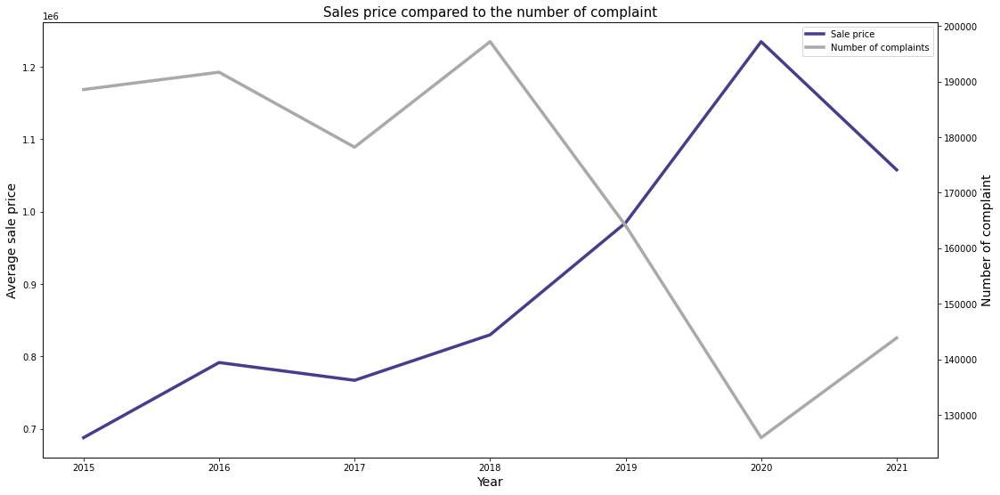

In [28]:
fig = plt.figure()
# plot sales price line
a = water_data.groupby('Year')['Median_Sales'].mean().plot(kind='line', figsize=(18,9), color='darkslateblue',  
                                                                                            label='Sale price',lw=3.5)
# make secondary yaxis
a1 = a.twinx()
# plot amount of complaints line
water_data.groupby('Year')['Amount of Complaints'].sum().plot(kind='line',figsize=(18,9),color='darkgrey',ax=a1, 
                                                                                label='Number of complaints', lw=3.5)

a1.set_ylabel('Number of complaint', fontsize=14)
a.set_ylabel('Average sale price', fontsize=14)
a.set_xlabel('Year', fontsize=14)
a.set_title('Sales price compared to the number of complaint', fontsize=15)

# put both labels inside the graph
handles,labels = [],[]
for ax in fig.axes:
    for h,l in zip(*ax.get_legend_handles_labels()):
        handles.append(h)
        labels.append(l)

plt.legend(handles,labels);

The graph above shows a clear trend, as housing prices increase the water complaints decrease. Could this be a coincidence or are the housing prices affected by the water quality? 

Let's take a closer look at how housing prices and water complaints interact in each of the top 10 neighborhoods with the highest complaints. Again, this was dene to not give an overflow of information, as we assume that this reveals the entire concept.

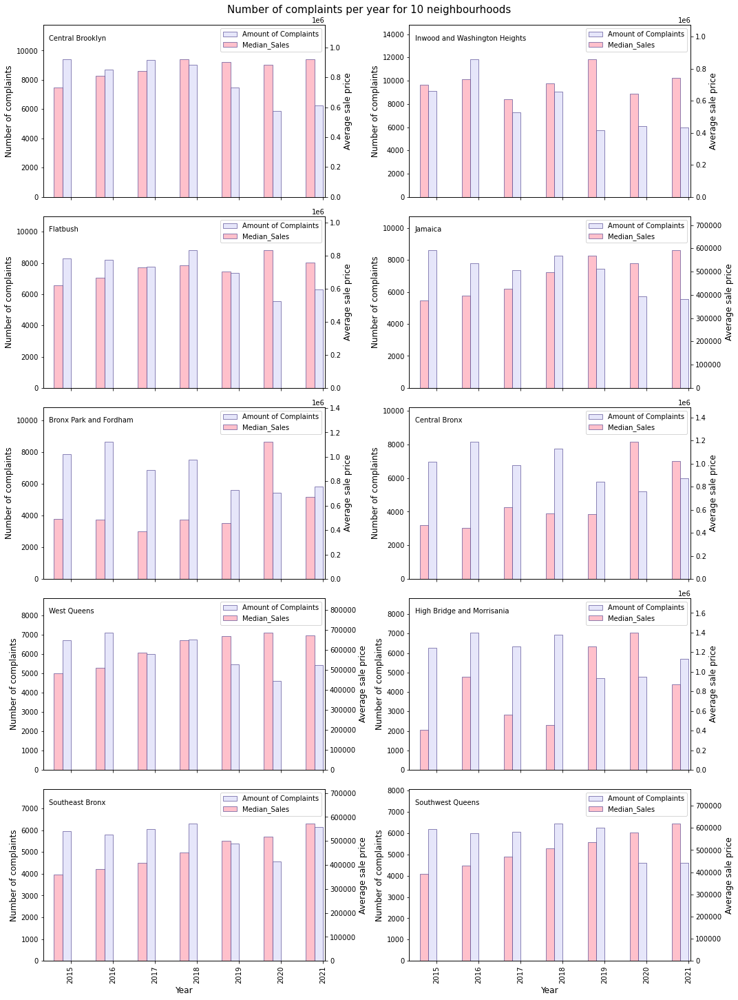

In [29]:
# plot subplot with amount of complaints and median sales
nrows = int(len(top10_neigh_comp)/2)
ncol = 2
fig, axes = plt.subplots(nrows, ncol, sharex=True,  figsize =(15,20))
width = 0.2


count = 0
for row in range(nrows):
    for col in range(ncol):
        neigh = top10_neigh_comp[count]
        focus_neigh_groupby_comp = water_data.groupby(['Neighborhood', 'Year'])['Amount of Complaints'].sum()
        focus_neigh_groupby_sales = water_data.groupby(['Neighborhood', 'Year'])['Median_Sales'].mean()
 
        ax = focus_neigh_groupby_comp[neigh].plot(ax = axes[row, col], kind='bar', width = 0.2, color='lavender', 
                                                                 position=1,edgecolor='darkslateblue', linewidth=0.6)
        
        ax2 = ax.twinx()
        ax2= focus_neigh_groupby_sales[neigh].plot(ax = ax2, kind='bar',width = 0.2, color='pink', 
                                                                position=2, edgecolor='darkslateblue', linewidth=0.6)
        ax.set_ylabel('Number of complaints', fontsize=12)
        ax.set_xlabel('Year', fontsize=12)
        max_range = focus_neigh_groupby_comp[neigh].max()
        ax.set_ylim([0, max_range+max_range/4])
        ax.text(0.02,0.91, neigh, transform=ax.transAxes)
        
        max_range2 = focus_neigh_groupby_sales[neigh].max()
        ax2.set_ylabel('Average sale price', fontsize=12)
        ax2.set_ylim([0, max_range2+max_range2/4])

        # ask matplotlib for the plotted objects and their labels
        lines, labels = ax.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax2.legend(lines + lines2, labels + labels2, loc="upper right")

        
        count += 1
fig.tight_layout()       
fig.text(0.5, 1, 'Number of complaints per year for 10 neighbourhoods', ha='center', va='center', fontsize=15);

In most of the neighborhoods a pattern is noticable. While house prices appear to be rising over time, the number of complaints seem to be decreasing. There might be a link between the two; as water complaints decline, neighborhood conditions improve, housing demand increases, and prices rise. However, there are numerous factors that influence houseing prices, and this might only be one of them.

A very intersting point is when looking at High Bridge and Morrisiana, Bronx Park and Fordham and Central Bronx, one can see that it is not following the same trend as the other neighborhoods. Housing prices have dropped from 2020-2021 while water complaints have been increasing. When taking a further look into those neighborhoods, it is extreamly interesting to see that all previously mentions neighborhoods are located within the Bronx borough which has the highest rate poverty compared to other boroughs in New York. [Ref: Bronx](https://www.bronximpact.org/history?fbclid=IwAR2MJT0EWIFux6x_-PXc_cNhMqUP-PJqwraquvQPd7cfHeu6VAavWCKT8Lw)


### 3.3 Contaminants and water complaints in neighborhoods  <a class="anchor" id="section_3_3"></a>

A country's economy and residents' health are both dependent on a healthy water supply. Citizens of a country without adequate drinking water are at an increased risk of contracting waterborne illnesses. The Centers for Disease Control and Prevention claims that the healthcare cost for diseases carried by water in the US are approximetly $ 3.3 billion, resulting in 6.600 fatalities. [Ref: Waterbrone diseases](https://www.circleofblue.org/2020/world/cdc-estimates-costs-of-waterborne-pathogens-in-the-united-states/)

Altough the drinking water in the United Stated is considered clean, instances of contamination going above acceptable limits in the water can still occur.

Now we will analyze the contaminates columns in the dataset to determine how they differ from neighborhoods.

In [30]:
def bokeh_plot(df,tit, y_label):
    src = ColumnDataSource(data = df)
    x = df['Neighborhood'].unique() #Complaint types
    col = df.columns[1]
    hover = HoverTool(tooltips=[("Average "+str(col).split('_')[-1], '@'+col)])
    #Create an empty figure
    p = figure(plot_width = 900
               ,plot_height = 600
               ,title = tit
               ,y_axis_label = y_label
                ,x_axis_label = 'Number of complaints'
               ,x_range = x
              ,tools=[hover])

    #Add bars by using p.var
    col = ['Neighborhood',df.columns[1]]
    bar ={} 
    items = []
    for indx,i in enumerate(col):
        bar[i] = p.vbar(x='Neighborhood', top=i, source= src, width=0.5,\
                        color="lavender",line_color = "darkslateblue")
        items.append((i, [bar[i]]))

    
    p.title.text_font_size = '14pt'
    p.title.align = 'center'
    p.xaxis.major_label_orientation = 1
    return p

In [31]:
contaminate = ['Avg_Residual_Free_Chlorine','Avg_Turbidity', 'Avg_Fluoride','Avg_Coliform']
df_contaminate = water_data.groupby(['Neighborhood'])[contaminate].apply(lambda x : x.mean())
measures = ['mg/L', 'NTU', 'mg/L', 'MPN /100mL']

In [32]:
# make the tabs for different contaminates
all_tabs = []
count = 0
for c in contaminate:
    df = df_contaminate[c].reset_index()
    tit = 'Average '+str(c).split('_')[-1]+' in neighborhoods'
    y_label = measures[count]
    p = bokeh_plot(df, tit, y_label)
    tab = Panel(child=p , title = str(c).split('_')[-1])
    all_tabs.append(tab)
    count += 1

tabs = Tabs(tabs=all_tabs)
show(tabs)

Now it can be seen how the different contaminate vary between neighborhoods.
Firstly Chlorine is measured highest in Bronx Park and Fordham at 0.744 mg/L and the lowest at Low East Site at 0.337 mg/L. Drinking water that is considered safe can have up top 5 mg/L of chlorine in the water, which means chorine in the New York water does not exceed the limit. [Ref: Water disinfection](https://www.cdc.gov/healthywater/drinking/public/water_disinfection.html#:~:text=What%20are%20safe%20levels%20of,effects%20are%20unlikely%20to%20occur)

Secondly, when we look at Turbidity in the water, which is a measure of how clear the water is. Solid particles suspended in liquids generates Turbidity. The scattering of light by these particles causes the liquid to seem foggy or muddy. Turbidity is a common way to determine water quality. When the difference in Turbidity is compared between neighborhoods the highest value of 0.797 NTU is in Port Richmond and the lowest values is in East Harlem with 0.460 NTU. [Ref: Causes of turbidity](https://aosts.com/what-causes-turbidity-in-water-importance/)
The maximum amount of turbidity in drinking water prescribed by the US Environmental Protection Agency is 1 NTU. [Ref: Turbidity](https://iwaponline.com/jwh/article/17/2/204/65912/Turbidity-reduction-in-drinking-water-by)

Fluoride in drinking water can be up to 4 mg/L to be considered safe. The figure shows that Fluoride is almost exactly the same between neighborhoods and they are all well below that boundary. [Ref: Fluoride](https://www.epa.gov/sites/default/files/2015-10/documents/2011_fluoride_questionsanswers.pdf)

Lastly when Coliform in the water is analyzed we see a clear difference between neighborhoods. Coliform bacteria may be found in the environment and in the feces of all animals, including humans. They exist in drinking water but do generally not cause sickness, however no sample should contain more than 10 coliform organisms per 100 ml.

Lets now take a further look into how many incidences occur where these contaminates go above allowed limit.

In [33]:
print('Incidences when Turbidity goes above limits:',len(water_data[water_data['Avg_Turbidity'] > 1]))
print('Incidences when Coliform goes above limits:',len(water_data[water_data['Avg_Coliform'] > 10]))
print('Incidences when Chlorine goes above limits:',len(water_data[water_data['Avg_Residual_Free_Chlorine'] > 5]))
print('Incidences when Fluoride goes above limits:',len(water_data[water_data['Avg_Fluoride'] > 4]))

Incidences when Turbidity goes above limits: 3527
Incidences when Coliform goes above limits: 526
Incidences when Chlorine goes above limits: 0
Incidences when Fluoride goes above limits: 0


Since Coliform and Turbidity are the only ones with incidences above limits, we will do further analysis on them.

In [34]:
coli_df = water_data[water_data['Avg_Coliform'] > 10]
turb_df = water_data[water_data['Avg_Turbidity'] > 1]

In [35]:
coli_df_plot = coli_df.groupby('Neighborhood')['Amount of Complaints'].sum()
coli_df_plot = coli_df_plot.reset_index()
coli_df_plot = coli_df_plot.set_index('Neighborhood')
turb_df_plot = turb_df.groupby('Neighborhood')['Amount of Complaints'].sum()
turb_df_plot = turb_df_plot.reset_index()
turb_df_plot = turb_df_plot.set_index('Neighborhood')

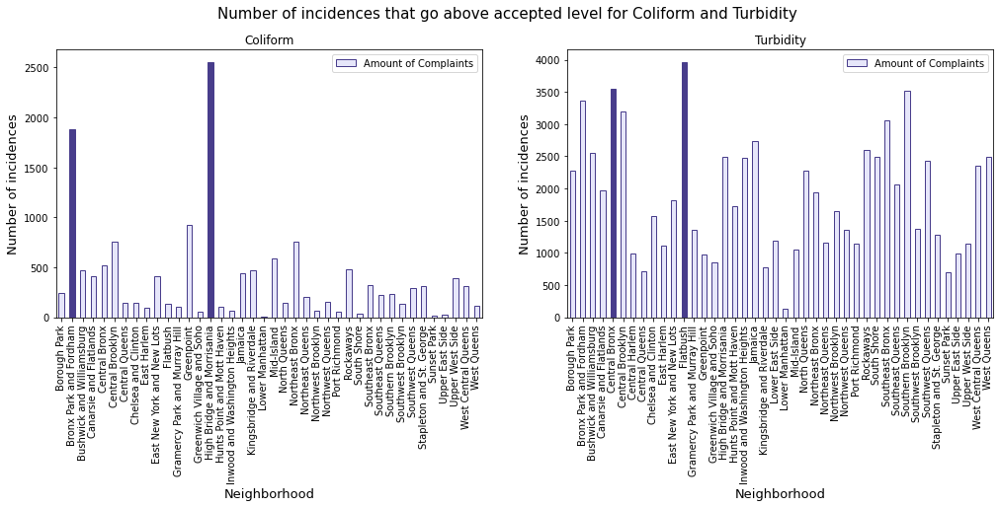

In [36]:
fig, axarr = plt.subplots(1, 2, figsize=(17, 5))

# Plots by index, groups are different columns, illustrated by taking transpose in second subplot
ax = coli_df_plot.plot(kind='bar',color='lavender', edgecolor='darkslateblue',ax=axarr[0], title ='Coliform')

ax1 = turb_df_plot.plot(kind='bar',color='lavender', edgecolor='darkslateblue',ax=axarr[1], title ='Turbidity')

fig.text(0.5, 0.98, 'Number of incidences that go above accepted level for Coliform and Turbidity ', 
                                                                             ha='center', va='center', fontsize=15);


# highlight the highest values
highest_col = coli_df_plot['Amount of Complaints'].nlargest(2).index[0]
second_highest_col = coli_df_plot['Amount of Complaints'].nlargest(2).index[1]
pos = coli_df_plot.index.get_loc(highest_col)
pos1 = coli_df_plot.index.get_loc(second_highest_col)
ax.patches[pos].set_facecolor('darkslateblue')
ax.patches[pos1].set_facecolor('darkslateblue')
ax.set_ylabel('Number of incidences', fontsize=13)
ax.set_xlabel('Neighborhood', fontsize=13)

highest_turb = turb_df_plot['Amount of Complaints'].nlargest(2).index[0]
second_highest_turb = turb_df_plot['Amount of Complaints'].nlargest(2).index[1]
pos2 = turb_df_plot.index.get_loc(highest_turb)
pos3 = turb_df_plot.index.get_loc(second_highest_turb)
ax1.patches[pos2].set_facecolor('darkslateblue')
ax1.patches[pos3].set_facecolor('darkslateblue')
ax1.set_ylabel('Number of incidences', fontsize=13)
ax1.set_xlabel('Neighborhood', fontsize=13);

The two figures above show the instances where the two conteminants exceed allowed limit within the different neighborhoods. The highlighted bars on the figures are the top two highest incidences for Coliform and Turbidity. A very interesting finding is that these four highlighted neighborhoods are all located in the Bronx borough. The neighborhoods that have the lowest incidences in the two figures are for exmaple Lower Manhattan, Chelsea and Clinton and East Harlem. Unsurprisingly these neighborhoods are located in Manhattan, and we havve seen before in the map of housing prices, Manhattan was one of the most expensive areas of New York. 

As Coliform incidences are very severe, they have a lower number of incidences then the Turbidity ones. Moreover, when looking at the highlighted neighborhoods for Coliform, we can see that they are way above the others, meaning the difference is extreme. Looking at the Turbidity incidences, we can see that they are more equally distributed between the neighborhoods.

Let's now analyse these two boroughs, Bronx and Manhattan, for the Coliform even further throughout the last six years.

In [37]:
# make a new datarfame the only Bronx borough
bronx_df = water_data[water_data['Borough']=='Bronx']
bronx_df_bronx = bronx_df.groupby(['Month_Year'])['Amount of Complaints'].sum()
bronx_df_bronx2 = bronx_df.groupby(['Month_Year'])['Avg_Coliform'].sum()
bronx_df_bronx2 = pd.merge(bronx_df_bronx, bronx_df_bronx2, on=['Month_Year'], how='left')

In [38]:
bronx_df1 = bronx_df[bronx_df['Avg_Coliform']>10]

In [39]:
# make a new dataframe with only Manhattan borough
manhattan_df = water_data[water_data['Borough']=='Manhattan']
manhattan_df_manhattan = manhattan_df.groupby(['Month_Year'])['Amount of Complaints'].sum()
manhattan_df_manhattan2 = manhattan_df.groupby(['Month_Year'])['Avg_Coliform'].sum()
manhattan_df_manhattan2 = pd.merge(manhattan_df_manhattan, manhattan_df_manhattan2, on=['Month_Year'], how='left')

In [40]:
manhattan_df1 = manhattan_df[manhattan_df['Avg_Coliform']>10]

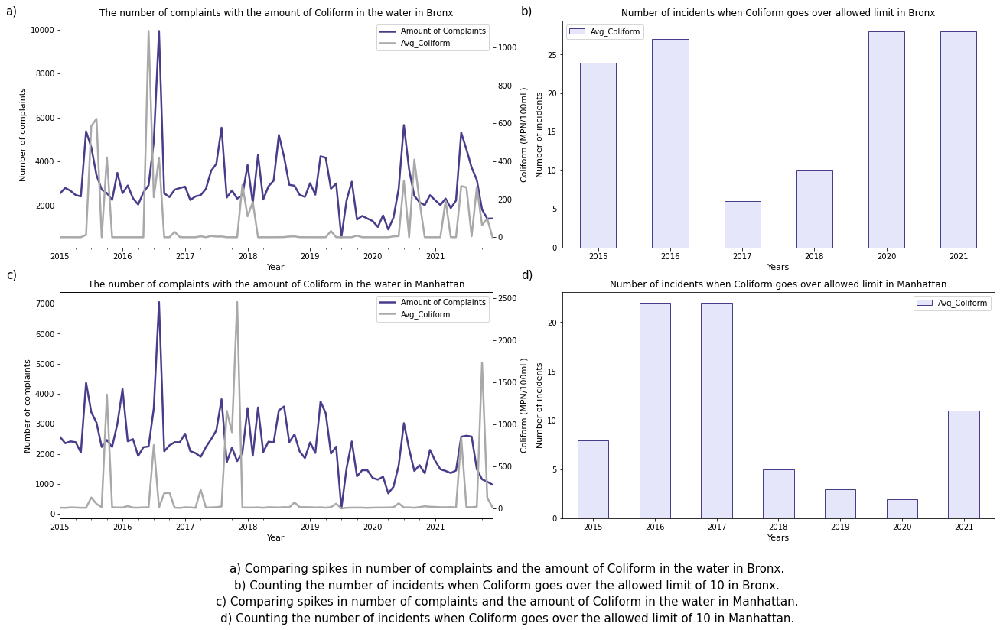

In [41]:
# make a subplot of 4 figures
fig, axarr = plt.subplots(2, 2, figsize=(18, 10))


# plot the number of complaints with the amount of coliform in the water for Bronx
a = bronx_df_bronx2['Amount of Complaints'].plot(color='darkslateblue', lw=2.5, 
                                                                     ax=axarr[0][0])
a1 = a.twinx()
bronx_df_bronx2['Avg_Coliform'].plot(ax=a1, color='darkgrey', lw=2.5);

a1.set_ylabel('Coliform (MPN/100mL)', fontsize=11)
axarr[0][0].set_ylabel('Number of complaints', fontsize=11)
axarr[0][0].set_xlabel('Year', fontsize=11)
axarr[0][0].set_title('The number of complaints with the amount of Coliform in the water in Bronx', fontsize=12)


# plot the number of incidetns when coliform goes over allowed limit in Bronx
bronx_df1.groupby('Year')['Avg_Coliform'].count().plot(kind='bar', color='lavender', edgecolor='darkslateblue', 
                                                                                                rot=0, ax=axarr[0][1])
axarr[0][1].set_title('Number of incidents when Coliform goes over allowed limit in Bronx', fontsize=12)
axarr[0][1].set_ylabel('Number of incidents', fontsize=11)
axarr[0][1].set_xlabel('Years', fontsize=11)

# put both labels inside the graph
handles,labels = [],[]
for ax in fig.axes:
    for h,l in zip(*ax.get_legend_handles_labels()):
        handles.append(h)
        labels.append(l)
        
lab_line = []
hand_line = []
hand_bar = []
lab_bar = []
lab_line.append(labels[0])
lab_line.append(labels[2])
hand_line.append(handles[0])
hand_line.append(handles[2])
hand_bar.append(handles[1])
lab_bar.append(labels[1])

axarr[0][0].legend(hand_line,lab_line)
axarr[1][0].legend(hand_line,lab_line)
axarr[0][1].legend(hand_bar,lab_bar)
axarr[1][1].legend(hand_bar,lab_bar)


# plot the number of complaints with the amount of coliform in the water for Manhattan
a = manhattan_df_manhattan2['Amount of Complaints'].plot(color='darkslateblue', lw=2.5, 
                                                                   ax=axarr[1][0])
a2 = a.twinx()
manhattan_df_manhattan2['Avg_Coliform'].plot(ax=a2, color='darkgrey', lw=2.5);

a2.set_ylabel('Coliform (MPN/100mL)', fontsize=11)
axarr[1][0].set_ylabel('Number of complaints', fontsize=11)
axarr[1][0].set_xlabel('Year', fontsize=11)
axarr[1][0].set_title('The number of complaints with the amount of Coliform in the water in Manhattan', fontsize=12)


# plot the number of incidetns when coliform goes over allowed limit in Manhattan
manhattan_df1.groupby('Year')['Avg_Coliform'].count().plot(kind='bar', color='lavender', edgecolor='darkslateblue', 
                                                                                                rot=0, ax=axarr[1][1])
axarr[1][1].set_title('Number of incidents when Coliform goes over allowed limit in Manhattan', fontsize=12)
axarr[1][1].set_ylabel('Number of incidents', fontsize=11)
axarr[1][1].set_xlabel('Years', fontsize=11)


# mark the figrues
plt.figtext(0.0, 0.98,
            "a)",
            horizontalalignment ="center", 
            verticalalignment ="center", 
            wrap = True, fontsize = 15, 
            color ="black")
plt.figtext(0.52, 0.98,
            "b)",
            horizontalalignment ="center", 
            verticalalignment ="center", 
            wrap = True, fontsize = 15, 
            color ="black")
plt.figtext(0.0, 0.50,
            "c)",
            horizontalalignment ="center", 
            verticalalignment ="center", 
            wrap = True, fontsize = 15, 
            color ="black")

plt.figtext(0.52, 0.50,
            "d)",
            horizontalalignment ="center", 
            verticalalignment ="center", 
            wrap = True, fontsize = 15, 
            color ="black")
plt.tight_layout()

# text under the figrues
fig.text(0.5, -0.04, 'a) Comparing spikes in number of complaints and the amount of Coliform in the water in Bronx.'
                                                                                        , ha='center', fontsize=15)
fig.text(0.5, -0.07, 'b) Counting the number of incidents when Coliform goes over the allowed limit of 10 in Bronx.'
                                                                                         ,ha='center', fontsize=15)
fig.text(0.5, -0.10, 'c) Comparing spikes in number of complaints and the amount of Coliform in the water in Manhattan.'
                                                                                         ,ha='center',fontsize=15)
fig.text(0.5, -0.13, 'd) Counting the number of incidents when Coliform goes over the allowed limit of 10 in Manhattan.'
                                                                                         ,ha='center',fontsize=15);

Figures a) and c) show the number of complaints and the average amount of coliform in the water in Bronx and Manhattan. We can see on the Bronx figure that there is a clear pattern between the amout of colifrom and the number of complaints. Both of them seem to have spikes at the same time and the number of complaints line somewhat follows the amount of coliform line. However in the Manhattan figure the trend is not as clear, and the spikes in number of complaints is not as predictable as it is for Bronx.

Figures b) and d) show the incidences were colifrom exceeds the allowed limit, in both Bronx and Manhattan. These two figures are very inline with figures a) and c). 

One very interesting finding is that the difference in the colifrom y-axis between Bronx and Manhattan is enormous, while the difference in the complaint axis between the two is minor. This could indicate that even though the water quality is much worse in Bronx than in Manhattan, the people of Manhattan are still almost complaining as often.

### 3.4 Predictions  <a class="anchor" id="section_3_4"></a>

Now that we have investigated the water number of complaints, housing prices and contaminants in the water of New York City. It's time predict the number of water complaints using the features we have been looking at. 

We chose to do a regression model, as we are predicting the number of complaints occuring. Random Forest Regressor is a algorithm that relies the power of multiple decision trees in decision making. Each node in the decision tree works on a random subset of features to caluclate the output, then it combines the output og individual decision trees to generate the final output. As diversity is attached, prediction becomes much smoother and that is why we decided to go with the random forrest regressor as well as its tendency to maintain accuracy of a large proportion of data.  [Ref: Decision tree](https://www.analyticsvidhya.com/blog/2020/05/decision-tree-vs-random-forest-algorithm/)

In [42]:
# one hot encoder
onehotencoder = OneHotEncoder()

In [43]:
# Encode the features race and sex
feature_array = onehotencoder.fit_transform(water_data[['postalcode', 'Month', 'Year',
                                                                'Complaint Type']]).toarray()
feature_labels = onehotencoder.categories_
feature_labels = np.concatenate(feature_labels, axis=None).tolist()
feature_df = pd.DataFrame(feature_array, columns = feature_labels)

In [44]:
water_data[['postalcode','Month', 'Year','Complaint Type']].reset_index()
df_clean = pd.concat([water_data[['Median_Sales', 'Sum_Sales',
    'Avg_Sales', 'Amount_Sales', 'Sum_Residential_Units', 'Sum_Commercial_Units', 
    'Sum_land_square_Group','Sum_gross_land_square_Group','Avg_Residual_Free_Chlorine', 
    'Avg_Turbidity', 'Avg_Fluoride','Avg_Coliform','Amount of Complaints'
    ]].reset_index(), feature_df], axis = 1).drop(['index'], axis=1)

In [45]:
# split the dataframe; target variable (df_y) and features (df_x)
y = df_clean[['Amount of Complaints']].values
X = df_clean[['Median_Sales', 'Sum_Sales','Avg_Sales', 'Amount_Sales', 'Sum_Residential_Units',
              'Sum_Commercial_Units', 'Sum_land_square_Group','Sum_gross_land_square_Group',
    10001, 10002, 10003, 10004, 10005, 10006, 10007, 10009, 10010, 10011, 10012,
    10013, 10014, 10016, 10017, 10018, 10019, 10021, 10022, 10023, 10024, 10025, 
    10026, 10027, 10028, 10029, 10030, 10031, 10032, 10033, 10034, 10035, 10036, 
    10037, 10038, 10039, 10040, 10044, 10065, 10069, 10075, 10112, 10128, 10129, 
    10179, 10280, 10282, 10301, 10302, 10303, 10304, 10305, 10306, 10307, 10308, 
    10309, 10310, 10312, 10314, 10451, 10452, 10453, 10454, 10455, 10456, 10457, 
    10458, 10459, 10460, 10461, 10462, 10463, 10464, 10465, 10466, 10467, 10468, 
    10469, 10470, 10471, 10472, 10473, 10474, 10475, 11001, 11004, 11005, 11040, 
    11101, 11102, 11103, 11104, 11105, 11106, 11109, 11201, 11203, 11204, 11205,  
    11206, 11207, 11208, 11209, 11210, 11211, 11212, 11213, 11214, 11215, 11216, 
    11217, 11218, 11219, 11220, 11221, 11222, 11223, 11224, 11225, 11226, 11228,
    11229, 11230, 11231, 11232, 11233, 11234, 11235, 11236, 11237, 11238, 11239, 
    11249, 11354, 11355, 11356, 11357, 11358, 11360, 11361, 11362, 11363, 11364, 
    11365, 11366, 11367, 11368, 11369, 11370, 11372, 11373, 11374, 11375, 11377, 
    11378, 11379, 11385, 11411, 11412, 11413, 11414, 11415, 11416, 11417, 11418, 
    11419, 11420, 11421, 11422, 11423, 11426, 11427, 11428, 11429, 11430, 11432, 
    11433, 11434, 11435, 11436, 11691, 11692, 11693, 11694, 11697, 
    1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
    2015, 2016, 2017, 2018, 2019, 2020, 2021,
    'Drinking Water', 'Indoor Sewage', 'Plumbing', 'Root/Sewer/Sidewalk Condition', 'Sewer',
    'Water Quality', 'Water System','Avg_Residual_Free_Chlorine', 'Avg_Turbidity', 'Avg_Fluoride','Avg_Coliform']].values

In [46]:
# split the data in train/test sets
X_train,X_test,y_train,y_test = train_test_split(X, y, test_size=0.2, random_state = 42)

In [47]:
# random foreset regressor model
regr = RandomForestRegressor(random_state=42, max_depth=40)

In [48]:
# fit the model
regr.fit(X_train, y_train.ravel())

RandomForestRegressor(max_depth=40, random_state=42)

In [49]:
# get predicted values
ypred = regr.predict(X_test)

In [50]:
# evaluate the results of the model
def evaluate(y_test, ypred):
    r2 = r2_score(y_test, ypred)
    mse = mean_squared_error(y_test, ypred, squared=False)
    mae = mean_absolute_error(y_test, ypred)
    return r2, mse, mae

In [51]:
r2, mse, mae = evaluate(y_test, ypred)

In [52]:
print('The r-squred score for the mode is:', r2)
print('The mean squared error for the mode is:', mse)
print('The mean absolute error for the mode is:', mae)

The r-squred score for the mode is: 0.6051569326908122
The mean squared error for the mode is: 17.961095530789322
The mean absolute error for the mode is: 8.398751612205876


The result of our model had an r-squared of **60.5%** in predicting water complaints on the test dataset. The mean squared error is **17.9** and the mean absolute error is **8.4** for our model, which is higher than we expected for our model



Because of the massive amount of data we have and the fact that we are using a Random Forest regressor, the processing requires a lot of computational power, we decided to choose a decision depth of only 40 layers.

In [53]:
X_features = df_clean[['Median_Sales', 'Sum_Sales','Avg_Sales', 'Amount_Sales', 'Sum_Residential_Units',
              'Sum_Commercial_Units', 'Sum_land_square_Group','Sum_gross_land_square_Group',
    10001, 10002, 10003, 10004, 10005, 10006, 10007, 10009, 10010, 10011, 10012,
    10013, 10014, 10016, 10017, 10018, 10019, 10021, 10022, 10023, 10024, 10025, 
    10026, 10027, 10028, 10029, 10030, 10031, 10032, 10033, 10034, 10035, 10036, 
    10037, 10038, 10039, 10040, 10044, 10065, 10069, 10075, 10112, 10128, 10129, 
    10179, 10280, 10282, 10301, 10302, 10303, 10304, 10305, 10306, 10307, 10308, 
    10309, 10310, 10312, 10314, 10451, 10452, 10453, 10454, 10455, 10456, 10457, 
    10458, 10459, 10460, 10461, 10462, 10463, 10464, 10465, 10466, 10467, 10468, 
    10469, 10470, 10471, 10472, 10473, 10474, 10475, 11001, 11004, 11005, 11040, 
    11101, 11102, 11103, 11104, 11105, 11106, 11109, 11201, 11203, 11204, 11205,  
    11206, 11207, 11208, 11209, 11210, 11211, 11212, 11213, 11214, 11215, 11216, 
    11217, 11218, 11219, 11220, 11221, 11222, 11223, 11224, 11225, 11226, 11228,
    11229, 11230, 11231, 11232, 11233, 11234, 11235, 11236, 11237, 11238, 11239, 
    11249, 11354, 11355, 11356, 11357, 11358, 11360, 11361, 11362, 11363, 11364, 
    11365, 11366, 11367, 11368, 11369, 11370, 11372, 11373, 11374, 11375, 11377, 
    11378, 11379, 11385, 11411, 11412, 11413, 11414, 11415, 11416, 11417, 11418, 
    11419, 11420, 11421, 11422, 11423, 11426, 11427, 11428, 11429, 11430, 11432, 
    11433, 11434, 11435, 11436, 11691, 11692, 11693, 11694, 11697, 
    1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
    2015, 2016, 2017, 2018, 2019, 2020, 2021,
    'Drinking Water', 'Indoor Sewage', 'Plumbing', 'Root/Sewer/Sidewalk Condition', 'Sewer',
    'Water Quality', 'Water System','Avg_Residual_Free_Chlorine', 'Avg_Turbidity', 'Avg_Fluoride','Avg_Coliform']]

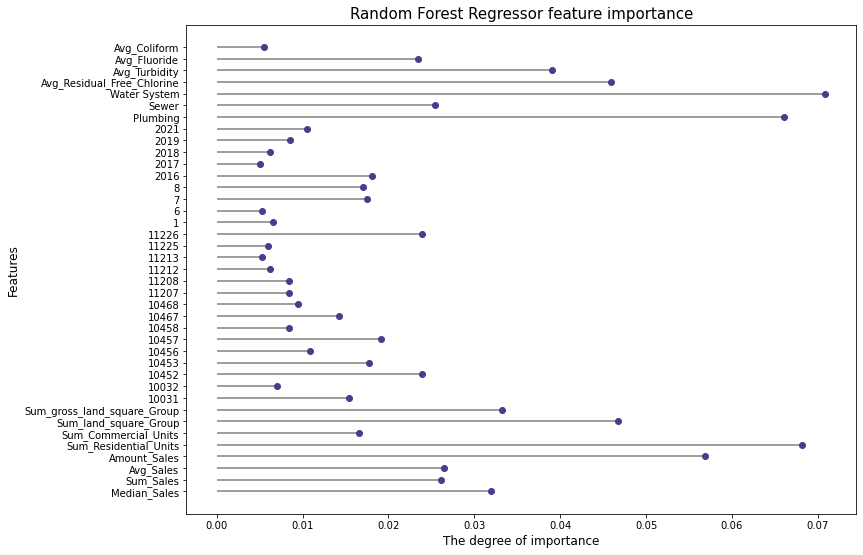

In [54]:
# make feature importance graph
figsize = plt.subplots(figsize = (12,9))

# since there are so many features - plot only those who are larget then 0.005
featues_mask = regr.feature_importances_> 0.005
std = np.std([tree.feature_importances_[featues_mask] for tree in regr.estimators_], axis=0)
my_range=range(sum(featues_mask))

# specifying the contents of the plot
plt.hlines(y=my_range, xmin=0, xmax=regr.feature_importances_[featues_mask], color='grey')
plt.errorbar(regr.feature_importances_[featues_mask], my_range, yerr = std, lw = 0, marker = 'o', 
                                                                                             color = 'darkslateblue')
plt.yticks(np.arange(sum(featues_mask)), X_features.columns[featues_mask])
plt.title("Random Forest Regressor feature importance", fontsize=15)
plt.xlabel("The degree of importance", fontsize=12)
plt.ylabel("Features", fontsize=12);

The figure above shows the feature importance of the Random Forest Regressor model. Since there are 223 featrues in the prediction model, it was decided to only visualize those of greater that 0.05 importance. 

We notice that there are a few zip codes that have greater affect on the model than other. When further analysing them there were six from Brooklyn, seven from Bronx and two from Manhattan, which could mena that living in Bronx or Brooklyn is of higher importance when predicting the amount of water complaints.

The features that have the most influence on the model are sewer, water system, sum of residental units, plumbing and the number of sales having the greatest importance. It is reasonalbe that sewer, water systems and plumbing are of high importance when predicting water complaints, since these are the most frequent complaint types in the dataset. The reason for the amount of sales and the sum of residental units being of such high important could possibly indicate that the popularity of neighborhoods could have affect on water complaints.

Just to briefly show how the Random Forest Regressor looks like. A visualization was created only showing three steps of the process, since in the original model we used a max_depth of 40, which would create a very large tree that is hard to read if visualized.

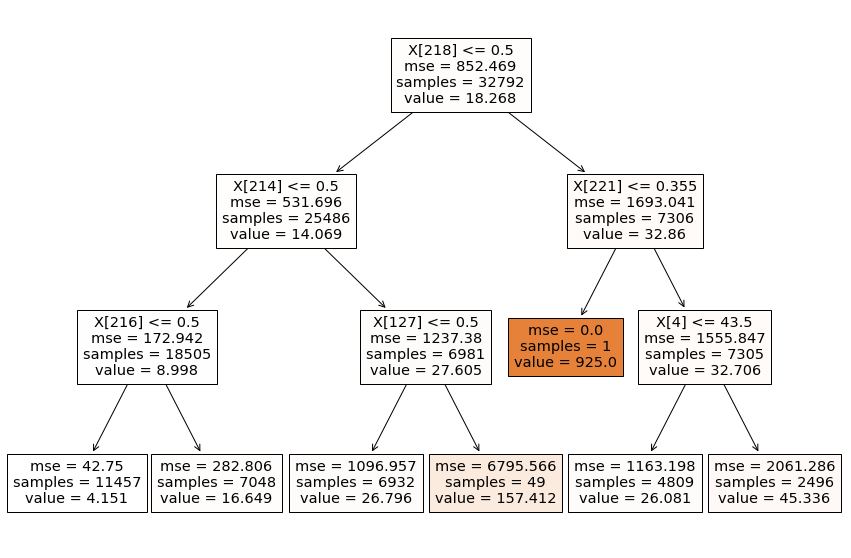

In [55]:
# plot the tree
rf_tree = RandomForestRegressor(random_state=42, max_depth=3)
rf_tree.fit(X_train, y_train.ravel())

fig = plt.figure(figsize=(15, 10))
tree.plot_tree(rf_tree.estimators_[0], filled=True)
plt.show()

### 3.5 Errors in the data  <a class="anchor" id="section_3_5"></a>

For the last part of this project, let's expore the errors in the data.

In [56]:
error_df_map =  water_data.groupby(['postalcode'])['Median_Sales'].mean()

In [57]:
error_df_map = error_df_map.reset_index()

In [58]:
# make a map without filtering
fig = px.choropleth_mapbox(error_df_map,
                           geojson=nycmap,
                           featureidkey='properties.postalcode',
                           locations='postalcode',
                           color='Median_Sales',
                           hover_name='postalcode',
                           color_continuous_scale='viridis',
                           mapbox_style='carto-positron',
                           title='Cumulative Numbers Complaints in NYC',
                           center={'lat':40.7594, 'lon':-73.9698},
                           zoom=12,
                           opacity=0.75,
                           width=1000,
                           height=800
                          )

fig.show()

One example of an error in the data is notisable when looking at the map above, showing the median sales price for all zip codes over the years of 2015-2021. When the map is displayed like this is looks as if there is no change bewteen areas and as if all zip codes have the same median sales price.

This is of course not correct, and when for example zooming closely on zip code 10022, which is located in Manhattan, a yellow color is observed underneath the purple color. When investigating this further, we found out that some zip codes were collapsing which lead to some information being lost. The yellow color on the plot was actually a specific zip code that had the number of 10112 and is a one house located on 500 Laxington avenue.

When creating the maps earlier on in this notebook, a trial and error method was used to filter out the collapsing zip codes so that it would not interfere with our results.

##  7. Reference <a class="anchor" id="chapter7"></a>



1. "Bronx impact". [Online]. Available: https://www.bronximpact.org/history?fbclid=IwAR2MJT0EWIFux6x_-PXc_cNhMqUP-PJqwraquvQPd7cfHeu6VAavWCKT8Lw. [May 9, 2022]

2. "CDC estimates cost of waterborn pathogens in the united states". [Online]. Available: https://www.circleofblue.org/2020/world/cdc-estimates-costs-of-waterborne-pathogens-in-the-united-states/. [Accessed: April 26, 2022]

3. "Decision tree vs random forest algorithm". [Online]. Available: https://www.analyticsvidhya.com/blog/2020/05/decision-tree-vs-random-forest-algorithm/. [Accessed: May 7, 2022]

4. "NYC new plan would let massive sewage overflows continue". [Online]. Available: https://www.nrdc.org/experts/larry-levine/nycs-new-plan-would-let-massive-sewage-overflows-continue. [April 23, 2022]

5. "Fluoride". [Online]. Available: https://www.epa.gov/sites/default/files/2015-10/documents/2011_fluoride_questionsanswers.pdf. [Accessed: May 9, 2022]

6. "Places to live". [Online]. Available: https://www.niche.com/places-to-live/n/chelsea-new-york-city-ny/?fbclid=IwAR3QlG12xYKBFKreXVPyuDTrocOnJ-. [April 26, 2022]

7. "The social wellbeing of New Yrok Cityes Neighborhoods". [Online]. Available: https://asimetrica.it2.com/wp-content/uploads/2020/01/The-Social-Wellbeing-of-New-York-Citys-Neighborhoods_-The-Contri.pdf?fbclid=IwAR2cAlHYTAvGRdtOtYGvMWvbFFre0Mj8mtor-flPggvADeq2LtrxghrTSWI. [May 10, 2022]

8. "Turbidity reduction in dirking water". [Online]. Available: https://iwaponline.com/jwh/article/17/2/204/65912/Turbidity-reduction-in-drinking-water-by. [Accessed: May 7, 2022]


9. "Water in cities". [Online]. Available: https://www.ais.unwater.org/ais/pluginfile.php/551/course/section/186/Water_in_Cities_Dvd-brochure.pdf. [May 9, 2022]

10. "Water disinfection". [Online]. Available: https://www.cdc.gov/healthywater/drinking/public/water_disinfection.html#:~:text=What%20are%20safe%20levels%20of,effects%20are%20unlikely%20to%20occur. [Accessed: April 26, 2022]


12. "What causes turbidity in water importance". [Oneline]. Available: https://aosts.com/what-causes-turbidity-in-water-importance/. [Accessed: April 26, 2022]


13. "What does median hous price mean?". [Online]. Available: https://www.westpac.com.au/personal-banking/home-loans/median-house-prices-explained/. [May 9, 2022]






